## Flight Passengers' Satisfaction Analysis and Prediction

**by Kelompok 2**

**> Members :**


*   Al'Ravie Mutiar Mahesa
*   Rangga Andhito Damahindra



**> Latar Belakang**

Analisis


* Mencari tahu alasan di balik kepuasan penumpang penerbangan dan faktor-faktor 
yang mempengaruhi.


* Melakukan perbandingan terhadap algoritma descision tree, random forest, dan SVM pada kasus ini.


* Menentukan metode terbaik di antara tanpa resampling, undersampling, dan oversampling pada kasus ini.




Prediksi


* Memperkirakan apa yang harus diprioritaskan ke depannya agar penumpang merasa puas ketika melakukan perjalanan udara.





**> Dataset**



> Link   : https://www.kaggle.com/teejmahal20/airline-passenger-satisfaction


> Source : *Kaggle*





## Metadata

Gender: Gender of the passengers (Female, Male)

Customer Type: The customer type (Loyal customer, disloyal customer)

Age: The actual age of the passengers

Type of Travel: Purpose of the flight of the passengers (Personal Travel, Business Travel)

Class: Travel class in the plane of the passengers (Business, Eco, Eco Plus)

Flight distance: The flight distance of this journey

Inflight wifi service: Satisfaction level of the inflight wifi service (0:Not Applicable;1-5)

Departure/Arrival time convenient: Satisfaction level of Departure/Arrival time convenient

Ease of Online booking: Satisfaction level of online booking

Gate location: Satisfaction level of Gate location

Food and drink: Satisfaction level of Food and drink

Online boarding: Satisfaction level of online boarding

Seat comfort: Satisfaction level of Seat comfort

Inflight entertainment: Satisfaction level of inflight entertainment

On-board service: Satisfaction level of On-board service

Leg room service: Satisfaction level of Leg room service

Baggage handling: Satisfaction level of baggage handling

Check-in service: Satisfaction level of Check-in service

Inflight service: Satisfaction level of inflight service

Cleanliness: Satisfaction level of Cleanliness

Departure Delay in Minutes: Minutes delayed when departure

Arrival Delay in Minutes: Minutes delayed when Arrival

Satisfaction: Airline satisfaction level(Satisfaction, neutral or dissatisfaction)

## Import Libraries and import file

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots
sns.set_style('darkgrid')
sns.set(rc={'figure.facecolor':'#EEEDDE','axes.edgecolor':'black'})

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving test.csv to test.csv
Saving train.csv to train.csv


## Read File & Data info

Read file

In [ ]:
file_path = 'train.csv'
df = pd.read_csv(file_path)
df.head()

,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied


mendapatkan informasi pada file

In [ ]:
df.shape # cek shape

(103904, 25)

In [ ]:
df.info() #mendapatkan info null dan type data di setiap features

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103904 entries, 0 to 103903
Data columns (total 25 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Unnamed: 0                         103904 non-null  int64  
 1   id                                 103904 non-null  int64  
 2   Gender                             103904 non-null  object 
 3   Customer Type                      103904 non-null  object 
 4   Age                                103904 non-null  int64  
 5   Type of Travel                     103904 non-null  object 
 6   Class                              103904 non-null  object 
 7   Flight Distance                    103904 non-null  int64  
 8   Inflight wifi service              103904 non-null  int64  
 9   Departure/Arrival time convenient  103904 non-null  int64  
 10  Ease of Online booking             103904 non-null  int64  
 11  Gate location                      1039

In [ ]:
df.describe(include='O')

,Gender,Customer Type,Type of Travel,Class,satisfaction
count,103904,103904,103904,103904,103904
unique,2,2,2,3,2
top,Female,Loyal Customer,Business travel,Business,neutral or dissatisfied
freq,52727,84923,71655,49665,58879


## Data Cleaning

#### Dropping column

In [ ]:
#making a data duplicate
df2 = df.copy()

In [ ]:
df2.drop(['Unnamed: 0', 'id', 'Gate location'], axis = 1, inplace=True) #melakukan drop pada 3 column tersebut


*   Kolom 'Unnamed: 0' merupakan kolom yang tidak jelas dan tidak berhubungan dengan keseluruhan data yang ada


*   Kolom id tidak memiliki korelasi dengan kenyamanan penumpang pesawat


*   Kolom 'Gate location' juga tidak memiliki korelasi dengan kenyamanan penumpang pesawat








In [ ]:
#pembuktian
pembuktian = df.copy()
pembuktian['satisfaction'] = pembuktian['satisfaction'].map({'neutral or dissatisfied':0,'satisfied':1})
pembuktian.corr()['satisfaction'].sort_values(ascending=False)

satisfaction                         1.000000
Online boarding                      0.503557
Inflight entertainment               0.398059
Seat comfort                         0.349459
On-board service                     0.322383
Leg room service                     0.313131
Cleanliness                          0.305198
Flight Distance                      0.298780
Inflight wifi service                0.284245
Baggage handling                     0.247749
Inflight service                     0.244741
Checkin service                      0.236174
Food and drink                       0.209936
Ease of Online booking               0.171705
Age                                  0.137167
id                                   0.013734
Gate location                        0.000682
Unnamed: 0                          -0.004731
Departure Delay in Minutes          -0.050494
Departure/Arrival time convenient   -0.051601
Arrival Delay in Minutes            -0.057582
Name: satisfaction, dtype: float64

Dapat dilihat dari hasil output di atas bahwa kolom 'Unnamed: 0', 'id', dan 'Gate location' memiliki nilai-nilai korelasi yang mendekati 0 dengan kolom-kolom yang lain, jadi kolom-kolom tersebut dapat didrop


In [ ]:
#checking duplicated values
df2.duplicated().sum() #tidak ada data yang duplicated

0

In [ ]:
#checking NaN values
df2.isna().sum()

Gender                                 0
Customer Type                          0
Age                                    0
Type of Travel                         0
Class                                  0
Flight Distance                        0
Inflight wifi service                  0
Departure/Arrival time convenient      0
Ease of Online booking                 0
Food and drink                         0
Online boarding                        0
Seat comfort                           0
Inflight entertainment                 0
On-board service                       0
Leg room service                       0
Baggage handling                       0
Checkin service                        0
Inflight service                       0
Cleanliness                            0
Departure Delay in Minutes             0
Arrival Delay in Minutes             310
satisfaction                           0
dtype: int64

In [ ]:
310/df2.shape[0]*100

0.29835232522328303

Karena terdapat 310 value yang memiliki nilai NaN pada kolom 'Arrival Delay in Minutes', lalu jika NaN tersebut drop maka hanya akan menghilangkan 0.298352% informasi tentang data saja, oleh karena itu kami melakukan drop

In [ ]:
df2.dropna(inplace=True) #dropping missing value

In [ ]:
df2.isna().sum().sum() # sudah tidak ada data yang kosong lagi

0

#### Deteksi outliers

In [ ]:
df2.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,103594.0,39.380466,15.113125,7.0,27.0,40.0,51.0,85.0
Flight Distance,103594.0,1189.325202,997.297235,31.0,414.0,842.0,1743.0,4983.0
Inflight wifi service,103594.0,2.729753,1.327866,0.0,2.0,3.0,4.0,5.0
Departure/Arrival time convenient,103594.0,3.060081,1.525233,0.0,2.0,3.0,4.0,5.0
Ease of Online booking,103594.0,2.756984,1.398934,0.0,2.0,3.0,4.0,5.0
Food and drink,103594.0,3.202126,1.329401,0.0,2.0,3.0,4.0,5.0
Online boarding,103594.0,3.250497,1.349433,0.0,2.0,3.0,4.0,5.0
Seat comfort,103594.0,3.439765,1.318896,0.0,2.0,4.0,5.0,5.0
Inflight entertainment,103594.0,3.358341,1.333030,0.0,2.0,4.0,4.0,5.0
On-board service,103594.0,3.382609,1.288284,0.0,2.0,4.0,4.0,5.0


karena nilai max dari Departure Delay in Minutes, Arrival Delay in Minutes, dan Flight Distance memiliki kenaikan yang signifikan dari pada 75% nya jadi kemungkinan terdapat outliers

In [ ]:
px.box(df2,x=['Flight Distance'],title='Sebelum Cleaning')


In [ ]:
px.box(df2,x=['Departure Delay in Minutes','Arrival Delay in Minutes'])

In [ ]:
#mari kita cek
print(df2['Flight Distance'].quantile(.99))
print(df2['Departure Delay in Minutes'].quantile(.99))
print(df2['Arrival Delay in Minutes'].quantile(.99))

3882.0
181.0
184.0


182 dan 185 menit keterlambatan dari data ke 99% atau quantile(0.99) memiliki perbedaan yang sangat jauh 1584 menit = 26 jam oleh karena itu data ini akan kami buang dengan menggunakan quantile saja

In [ ]:
df2.shape

(103594, 22)

In [ ]:
df2 = df2[df2['Arrival Delay in Minutes']<df2['Arrival Delay in Minutes'].quantile(.99)]
df2 = df2[df2['Departure Delay in Minutes']<df2['Departure Delay in Minutes'].quantile(.99)]
df2 = df2[df2['Flight Distance']<df2['Flight Distance'].quantile(.99)]
df2.shape

(100474, 22)

In [ ]:
px.box(df2,x=['Flight Distance'],title='Sesudah membuang 1 persen outliers')

In [ ]:
px.box(df2,x=['Departure Delay in Minutes','Arrival Delay in Minutes'])

In [ ]:
def transformasi_outliers(x):
    q1 = df2[x].quantile(.25)
    q3 = df2[x].quantile(.75)
    iqr = q3-q1
    upper = q3 + 1.5*iqr
    df2.loc[(df2[x]>upper),x] = df2[x].median()
    return df2


In [ ]:
df2 = transformasi_outliers('Flight Distance')
df2 = transformasi_outliers('Departure Delay in Minutes')
df2 = transformasi_outliers('Arrival Delay in Minutes')

In [ ]:
px.box(df2,x=['Flight Distance'],title='setelah tranformasi')

In [ ]:
px.box(df2,x=['Departure Delay in Minutes','Arrival Delay in Minutes'])

## Data Exploratory

#### Total Passenger Satisfaction 

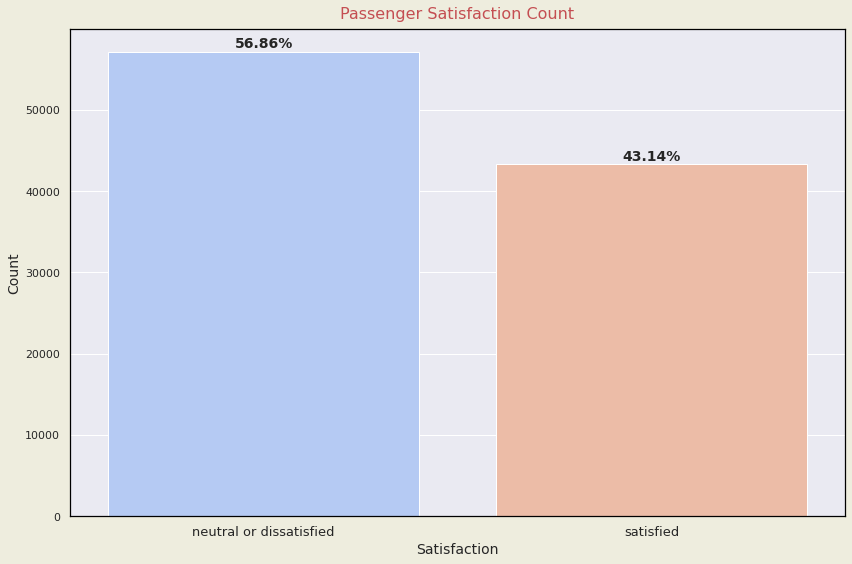

In [ ]:
sns.set(rc={'figure.facecolor':'#EEEDDE','axes.edgecolor':'black'})
fig, ax = plt.subplots(1,figsize=(12,8))
sns.countplot(x = df2['satisfaction'],palette='coolwarm',ax=ax)
ax.set_title('Passenger Satisfaction Count',pad=10,fontsize=16,c='r')
ax.set_xlabel('Satisfaction',fontsize=14)
ax.set_ylabel('Count',fontsize=14)
ax.set_xticklabels(df2.satisfaction.unique(),fontsize=13)
for i, value in enumerate(df2.satisfaction.value_counts()):
    ax.text(i,value*1.01,'%.2f%%'%float(value/df2.shape[0]*100),fontsize=14,weight='semibold',ha='center')
fig.tight_layout()
plt.show()

data less imbalanced 

data neutral or dissatisfied  56% dari total data sedangkan satisfied berjumlah 44% dari data 


#### Distribution data pada column categories

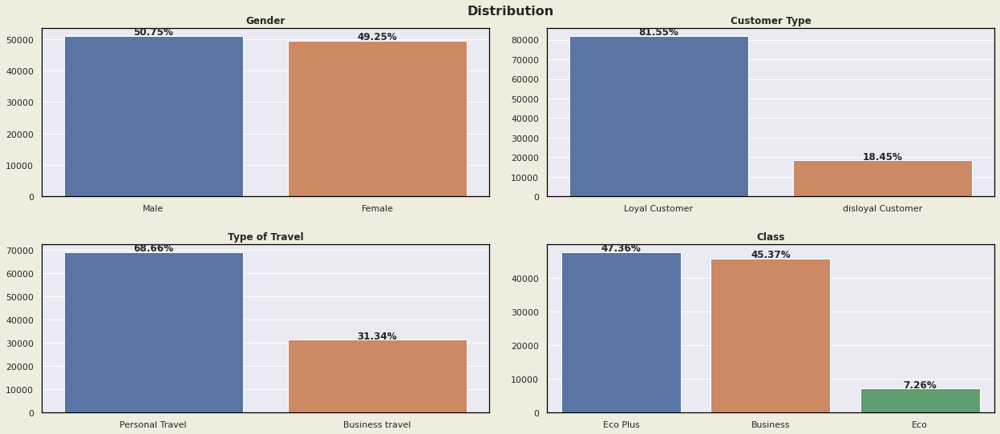

In [ ]:
fig,ax = plt.subplots(2,2,figsize=(18,8))
fig.suptitle('Distribution',fontsize=16,weight='bold')
fig.tight_layout(pad=3)

#plot gender
sns.barplot(x=df2['Gender'].unique(),y=df2['Gender'].value_counts(),ax=ax[0,0]).set_ylabel('')
ax[0,0].set_title('Gender',weight='bold')   
for i, value in enumerate(df2.Gender.value_counts()):
    ax[0,0].text(i,value*1.01,'%.2f%%'%float(value/df2.shape[0]*100),fontsize=12,weight='semibold',ha='center')

#plot Customer Type
sns.barplot(x=df2['Customer Type'].unique(),y=df2['Customer Type'].value_counts(),ax=ax[0,1]).set_ylabel('')
ax[0,1].set_title('Customer Type',weight='bold')
for i, value in enumerate(df2['Customer Type'].value_counts()):
    ax[0,1].text(i,value*1.01,'%.2f%%'%float(value/df2.shape[0]*100),fontsize=12,weight='semibold',ha='center')

#plot Type of Travel
sns.barplot(x=df2['Type of Travel'].unique(),y=df2['Type of Travel'].value_counts(),ax=ax[1,0]).set_ylabel('')
ax[1,0].set_title('Type of Travel',weight='bold')
for i, value in enumerate(df2['Type of Travel'].value_counts()):
    ax[1,0].text(i,value*1.01,'%.2f%%'%float(value/df2.shape[0]*100),fontsize=12,weight='semibold',ha='center')
    
#plot Class
sns.barplot(x=df2['Class'].unique(),y=df2['Class'].value_counts(),ax=ax[1,1]).set_ylabel('')
ax[1,1].set_title('Class',weight='bold')
for i, value in enumerate(df2.Class.value_counts()):
    ax[1,1].text(i,value*1.01,'%.2f%%'%float(value/df2.shape[0]*100),fontsize=12,weight='semibold',ha='center')

plt.show()

distribution dari setiap categorical data
pada grafik tersebut column gender hampir memiliki data yang balance
lalu pada grafik Class, class eco plus dan business hampir balance sedangkan eco memiliki data yang sangat sedikit
dan sisanya berupa data imbalance

#### Distribution pada column numeric

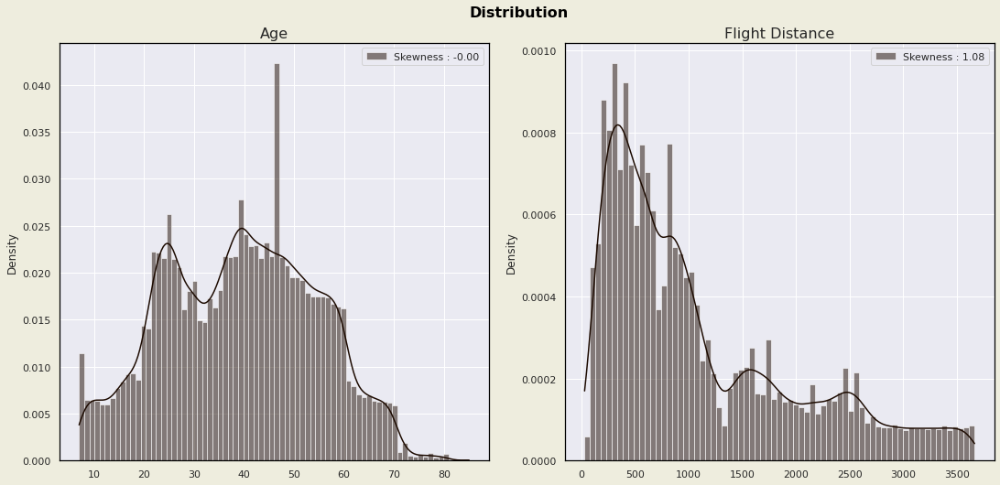

In [ ]:
fig, ax = plt.subplots(1,2,figsize = (16, 8))
fig.tight_layout(pad = 4)
fig.suptitle('Distribution',fontsize=16,color='black',weight='bold')

sns.histplot(ax=ax[0],x = df2['Age'].dropna(),stat='density',kde=True,label = "Skewness : %.2f"%(df2['Age'].skew()),color='#1C0A00').set_xlabel('')
ax[0].set_title('Age', fontsize = 16)
ax[0].legend(loc = 'best')

sns.histplot(ax=ax[1],x = df2['Flight Distance'],stat='density',kde=True,label = "Skewness : %.2f"%(df2['Flight Distance'].skew()),color='#1C0A00').set_xlabel('')
ax[1].set_title('Flight Distance', fontsize = 16)
ax[1].legend(loc = 'best')
plt.show()

column age memiliki data yang balance sedangkan flight distance memiliki data yang imbalanced

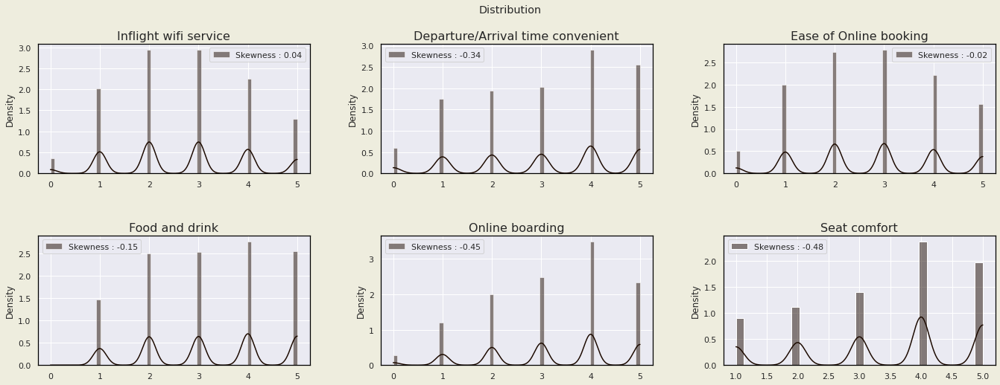

In [ ]:
fig, ax = plt.subplots(2,3,figsize = (20, 8))
fig.tight_layout(pad = 5)
fig.suptitle('Distribution')

sns.histplot(ax=ax[0,0],x = df2['Inflight wifi service'],stat='density',kde=True,label = "Skewness : %.2f"%(df2['Inflight wifi service'].skew()),color='#1C0A00').set_xlabel('')
ax[0,0].set_title('Inflight wifi service', fontsize = 16)
ax[0,0].legend(loc = 'best')

sns.histplot(ax=ax[0,1],x = df2['Departure/Arrival time convenient'],stat='density',kde=True,label = "Skewness : %.2f"%(df2['Departure/Arrival time convenient'].skew()),color='#1C0A00').set_xlabel('')
ax[0,1].set_title('Departure/Arrival time convenient', fontsize = 16)
ax[0,1].legend(loc = 'best')

sns.histplot(ax=ax[0,2],x = df2['Ease of Online booking'],stat='density',kde=True,label = "Skewness : %.2f"%(df2['Ease of Online booking'].skew()),color='#1C0A00').set_xlabel('')
ax[0,2].set_title('Ease of Online booking', fontsize = 16)
ax[0,2].legend(loc = 'best')

sns.histplot(ax=ax[1,0],x = df2['Food and drink'],stat='density',kde=True,label = "Skewness : %.2f"%(df2['Food and drink'].skew()),color='#1C0A00').set_xlabel('')
ax[1,0].set_title('Food and drink', fontsize = 16)
ax[1,0].legend(loc = 'best')

sns.histplot(ax=ax[1,1],x = df2['Online boarding'],stat='density',kde=True,label = "Skewness : %.2f"%(df2['Online boarding'].skew()),color='#1C0A00').set_xlabel('')
ax[1,1].set_title('Online boarding', fontsize = 16)
ax[1,1].legend(loc = 'best')

sns.histplot(ax=ax[1,2],x = df2['Seat comfort'],stat='density',kde=True,label = "Skewness : %.2f"%(df2['Seat comfort'].skew()),color='#1C0A00').set_xlabel('')
ax[1,2].set_title('Seat comfort', fontsize = 16)
ax[1,2].legend(loc = 'best')

plt.show()


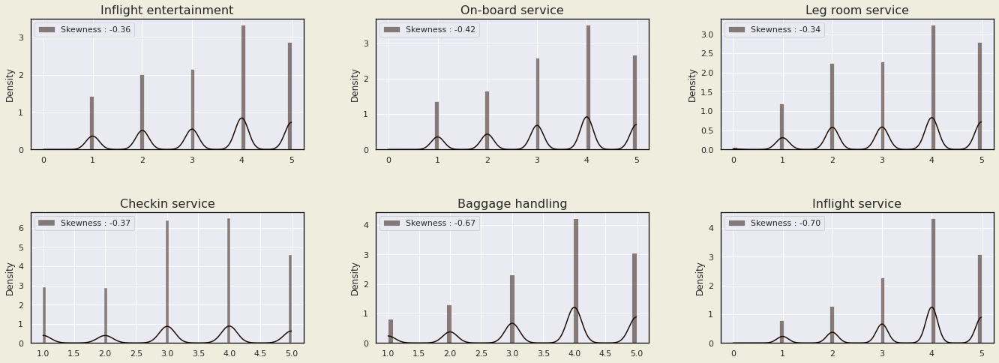

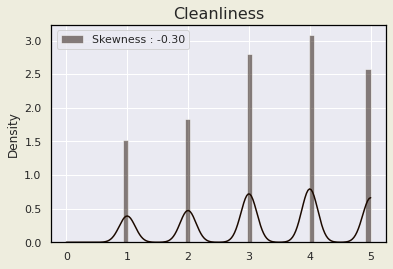

In [ ]:
fig, ax = plt.subplots(2,3,figsize = (20, 8))
fig.tight_layout(pad = 5)

sns.histplot(ax=ax[0,0],x = df2['Inflight entertainment'],stat='density',kde=True,label = "Skewness : %.2f"%(df2['Inflight entertainment'].skew()),color='#1C0A00').set_xlabel('')
ax[0,0].set_title('Inflight entertainment', fontsize = 16)
ax[0,0].legend(loc = 'best')

sns.histplot(ax=ax[0,1],x = df2['On-board service'],stat='density',kde=True,label = "Skewness : %.2f"%(df2['On-board service'].skew()),color='#1C0A00').set_xlabel('')
ax[0,1].set_title('On-board service', fontsize = 16)
ax[0,1].legend(loc = 'best')

sns.histplot(ax=ax[0,2],x = df2['Leg room service'],stat='density',kde=True,label = "Skewness : %.2f"%(df2['Leg room service'].skew()),color='#1C0A00').set_xlabel('')
ax[0,2].set_title('Leg room service', fontsize = 16)
ax[0,2].legend(loc = 'best')

sns.histplot(ax=ax[1,0],x = df2['Checkin service'],stat='density',kde=True,label = "Skewness : %.2f"%(df2['Checkin service'].skew()),color='#1C0A00').set_xlabel('')
ax[1,0].set_title('Checkin service', fontsize = 16)
ax[1,0].legend(loc = 'best')

sns.histplot(ax=ax[1,1],x = df2['Baggage handling'],stat='density',kde=True,label = "Skewness : %.2f"%(df2['Baggage handling'].skew()),color='#1C0A00').set_xlabel('')
ax[1,1].set_title('Baggage handling', fontsize = 16)
ax[1,1].legend(loc = 'best')

sns.histplot(ax=ax[1,2],x = df2['Inflight service'],stat='density',kde=True,label = "Skewness : %.2f"%(df2['Inflight service'].skew()),color='#1C0A00').set_xlabel('')
ax[1,2].set_title('Inflight service', fontsize = 16)
ax[1,2].legend(loc = 'best')

fig,ax = plt.subplots(1,figsize=(6,4))
sns.histplot(x = df2['Cleanliness'],stat='density',kde=True,label = "Skewness : %.2f"%(df2['Cleanliness'].skew()),color='#1C0A00').set_xlabel('')
ax.set_title('Cleanliness', fontsize = 16)
ax.legend(loc = 'best')


#### Perbandingan kepuasan pengguna airline pada umur

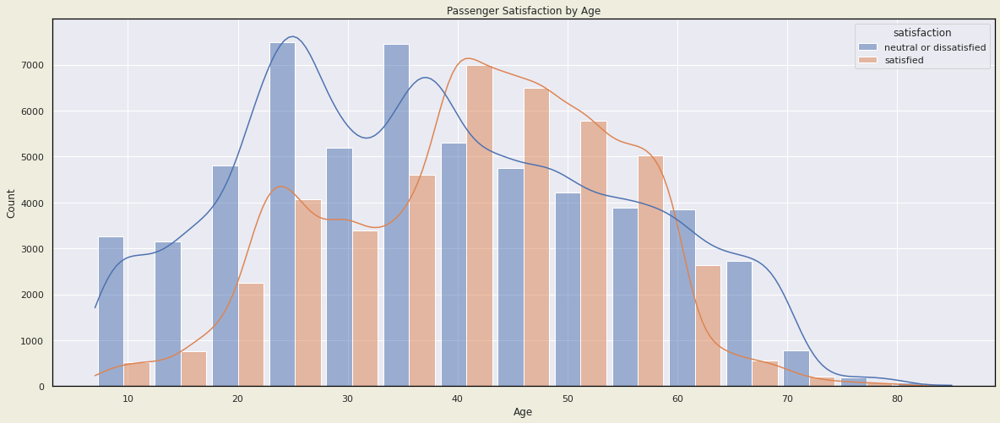

In [ ]:
fig,ax = plt.subplots(1,figsize=(20,8))
sns.histplot(data=df2,x='Age',bins=15,hue='satisfaction',multiple='dodge',element='bars',kde=True, shrink=.9)
ax.set_title('Passenger Satisfaction by Age')
plt.show()

rata-rata umur 36 kebawah memiliki ketidakpuasan atau netral sedangkan dari 36 hingga keatas memiliki kepuasan yang lebih ketika menaiki pesawat

##### Kepuasan pengguna pada umur per class


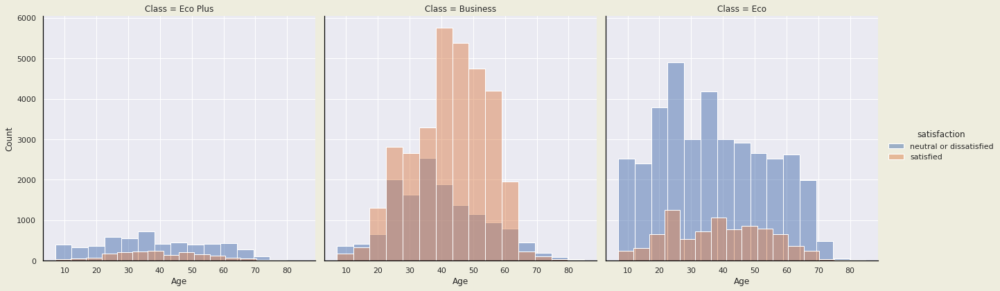

In [ ]:
# fig, ax = plt.subplots(1, figsize=(16,6))

g = sns.FacetGrid(data=df2,col='Class',hue='satisfaction',height=6)
g.map(sns.histplot,'Age',alpha=0.5,multiple='dodge',bins=15).add_legend()

jika kita membagi lagi berdasarkan class maka yang paling memiliki nilai satisfied adalah class business

##### Perbandingan jarak penerbangan dengan Class

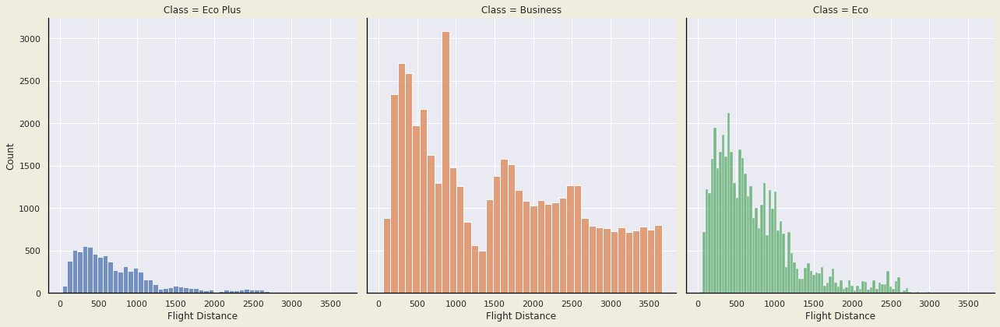

In [ ]:
g = sns.FacetGrid(data=df2,col='Class',hue='Class',height=6)
g.map(sns.histplot,'Flight Distance')

orang-orang lebih cenderung memilih Class Business bila jarak penerbangan melebihi 3000 km/mil.

#### Lalu apa Faktor yang mempengaruhi class business sehingga memiliki jumlah satisfied yang lebih tinggi dibandingkan class economi dan class eco plus?

##### kita lihat korelasinya per features supaya dapat mengambil beberapa sample untuk dibandingkan lebih lanjut

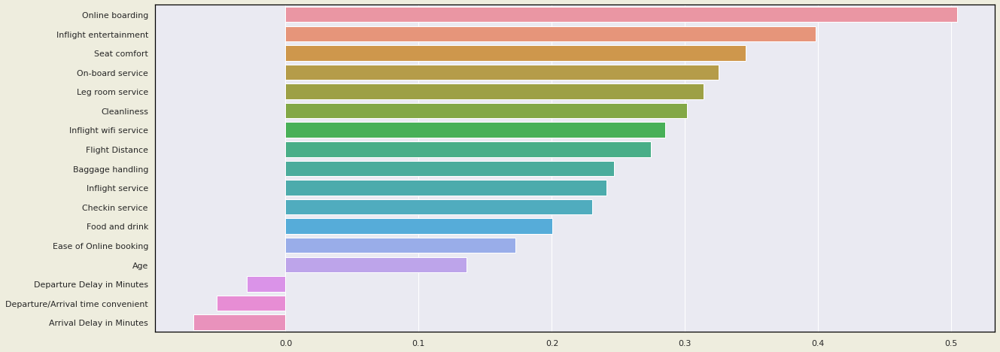

In [ ]:
data_corr = df2.copy()
data_corr['satisfaction'] = data_corr['satisfaction'].map({'neutral or dissatisfied':0,'satisfied':1})
data_corr = data_corr.corr()['satisfaction'].sort_values(ascending=False)[1:]
fig,ax = plt.subplots(1,figsize=(20,8))
sns.barplot(y=data_corr.index,x=data_corr.values,ax=ax)
plt.show()

pada grafik tersebut memperlihatkan korelasi yang mempengaruhi faktor satisfaction dan paling berpengaruh adalah Online boarding

##### oleh karena itu kita tinjau lebih lanjut menjadi per class

In [ ]:
fig1=px.histogram(data_frame=df2,x='Online boarding',barmode='group',color='Class')
fig2=px.histogram(data_frame=df2,x='Inflight entertainment',barmode='group',color='Class')
fig3=px.histogram(data_frame=df2,x='Seat comfort',color='Class',barmode='group')
fig4=px.histogram(data_frame=df2,x='Cleanliness',color='Class',barmode='group')

In [ ]:
fig = make_subplots(rows=2,cols=2,subplot_titles=('Online boarding','Inflight entertainment','Seat comfort','Cleanliness'))

fig.add_trace(fig1['data'][0],row=1,col=1)
fig.add_trace(fig1['data'][1],row=1,col=1)
fig.add_trace(fig1['data'][2],row=1,col=1)

fig2.data[0].showlegend=False
fig2.data[1].showlegend=False
fig2.data[2].showlegend=False

fig.add_trace(fig2['data'][0],row=1,col=2)
fig.add_trace(fig2['data'][1],row=1,col=2)
fig.add_trace(fig2['data'][2],row=1,col=2)

fig3.data[0].showlegend=False
fig3.data[1].showlegend=False
fig3.data[2].showlegend=False

fig.add_trace(fig3['data'][0],row=2,col=1)
fig.add_trace(fig3['data'][1],row=2,col=1)
fig.add_trace(fig3['data'][2],row=2,col=1)

fig4.data[0].showlegend=False
fig4.data[1].showlegend=False
fig4.data[2].showlegend=False

fig.add_trace(fig4['data'][0],row=2,col=2)
fig.add_trace(fig4['data'][1],row=2,col=2)
fig.add_trace(fig4['data'][2],row=2,col=2)

fig.show()

sebagian besar score yang dimiliki oleh class Business memiliki rating yang jauh lebih tinggi dibandingkan class-class lainnya

## Features Engineering

### Standarisasi

In [ ]:
#melakukan standarisasi pada data numerik
from sklearn.preprocessing import StandardScaler
numeric_data = df2.select_dtypes(include='number')
ss = StandardScaler()
scaled_data = ss.fit_transform(numeric_data)
standarized_data = pd.DataFrame(scaled_data, index = numeric_data.index, columns = numeric_data.columns)
print(standarized_data.shape)
standarized_data.head()

(100474, 17)


,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes
0,-1.740954,-0.723725,0.203035,0.615711,0.174747,1.349762,-0.181284,1.183129,1.230525,0.479102,-0.258601,0.313824,0.551031,1.153258,1.307446,3.651904,2.131961
1,-0.948134,-0.974736,0.203035,-0.694570,0.174747,-1.659012,-0.181284,-1.848145,-1.765761,-1.850008,1.257132,-0.531152,-1.821489,0.300113,-1.739973,-0.312325,0.378552
2,-0.882065,0.037118,-0.550167,-0.694570,-0.540485,1.349762,1.300039,1.183129,1.230525,0.479102,-0.258601,0.313824,0.551031,0.300113,1.307446,-0.477501,-0.498152
3,-0.948134,-0.609933,-0.550167,1.270851,1.605210,-0.906818,-0.921946,-1.090327,-1.016690,-1.073638,1.257132,-0.531152,-1.821489,0.300113,-0.978118,1.339437,0.816905
4,1.430329,-0.998164,0.203035,-0.039429,0.174747,0.597568,1.300039,1.183129,-0.267618,-0.297268,0.499265,0.313824,-0.239809,-0.553032,-0.216263,-0.477501,-0.498152


### one hot encoding

In [ ]:
#melakukan one hot encoding pada data categorical
from sklearn.preprocessing import OneHotEncoder
encoder = OneHotEncoder(sparse=False,drop='if_binary')
categorical_data = df2.select_dtypes(include='object')
print(categorical_data.shape)
categorical_data.head(3) #contoh sample yang akan diubah

(100474, 5)


,Gender,Customer Type,Type of Travel,Class,satisfaction
0,Male,Loyal Customer,Personal Travel,Eco Plus,neutral or dissatisfied
1,Male,disloyal Customer,Business travel,Business,neutral or dissatisfied
2,Female,Loyal Customer,Business travel,Business,satisfied


In [ ]:
# buat ngenamain label nya
def make_column_labels(data):
    output = list()
    for i in range(len(data)):
        index = data[i]
        for j in range(len(index)):
            if len(index)>2:
                output.append(index[j])
            else :
                output.append(index[1])
                break
    return output

In [ ]:
categorical_encode = pd.DataFrame(encoder.fit_transform(categorical_data), columns=make_column_labels(encoder.categories_)) #langsung dijadiin satu
print(categorical_encode.shape)
categorical_encode.head(3)

(100474, 7)


,Male,disloyal Customer,Personal Travel,Business,Eco,Eco Plus,satisfied
0,1.0,0.0,1.0,0.0,0.0,1.0,0.0
1,1.0,1.0,0.0,1.0,0.0,0.0,0.0
2,0.0,0.0,0.0,1.0,0.0,0.0,1.0


dijadikan satu dataframe

In [ ]:
#make a new DataFrame with new datas
df3 = pd.concat([standarized_data.reset_index(drop=True),categorical_encode.reset_index(drop=True)], axis = 1)
print(df3.shape)
df3.head()

(100474, 24)


,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,...,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Male,disloyal Customer,Personal Travel,Business,Eco,Eco Plus,satisfied
0,-1.740954,-0.723725,0.203035,0.615711,0.174747,1.349762,-0.181284,1.183129,1.230525,0.479102,...,1.307446,3.651904,2.131961,1.0,0.0,1.0,0.0,0.0,1.0,0.0
1,-0.948134,-0.974736,0.203035,-0.694570,0.174747,-1.659012,-0.181284,-1.848145,-1.765761,-1.850008,...,-1.739973,-0.312325,0.378552,1.0,1.0,0.0,1.0,0.0,0.0,0.0
2,-0.882065,0.037118,-0.550167,-0.694570,-0.540485,1.349762,1.300039,1.183129,1.230525,0.479102,...,1.307446,-0.477501,-0.498152,0.0,0.0,0.0,1.0,0.0,0.0,1.0
3,-0.948134,-0.609933,-0.550167,1.270851,1.605210,-0.906818,-0.921946,-1.090327,-1.016690,-1.073638,...,-0.978118,1.339437,0.816905,0.0,0.0,0.0,1.0,0.0,0.0,0.0
4,1.430329,-0.998164,0.203035,-0.039429,0.174747,0.597568,1.300039,1.183129,-0.267618,-0.297268,...,-0.216263,-0.477501,-0.498152,1.0,0.0,0.0,1.0,0.0,0.0,1.0


In [ ]:
df3.isna().sum().sum()

0

## Test Data

In [ ]:
df_test = pd.read_csv('test.csv')
df_test.sample(5)

,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
5641,5641,3795,Male,Loyal Customer,40,Business travel,Business,2679,1,1,...,4,4,4,4,5,4,3,0,4.0,satisfied
24078,24078,108770,Male,Loyal Customer,21,Business travel,Business,1936,2,4,...,4,4,3,4,3,5,4,2,0.0,satisfied
6358,6358,64547,Female,Loyal Customer,40,Business travel,Business,3953,1,1,...,4,4,4,4,5,4,5,0,0.0,satisfied
4329,4329,116809,Male,Loyal Customer,37,Business travel,Eco Plus,417,2,5,...,2,3,4,3,4,4,2,7,14.0,neutral or dissatisfied
10049,10049,7594,Male,Loyal Customer,57,Business travel,Business,1905,3,3,...,2,2,2,2,4,2,3,1,2.0,satisfied


In [ ]:
df_test.drop(['Unnamed: 0','id','Gate location'],axis=1,inplace=True)
df_test = df_test.dropna()
df_test.isna().sum().sum()

0

In [ ]:
df_test.shape

(25893, 22)

In [ ]:
numeric_data_test = df_test.select_dtypes(include='number')
standarized_data_test = pd.DataFrame(ss.transform(numeric_data_test), index = numeric_data_test.index, columns = numeric_data_test.columns)
print(standarized_data_test.shape)
standarized_data_test.head()

(25893, 17)


,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes
0,0.835713,-1.058407,1.709438,0.615711,0.174747,-0.154625,0.559378,-0.332508,1.230525,1.255471,1.257132,1.158800,-1.030649,1.153258,1.307446,7.781310,5.931015
1,-0.221381,1.957075,-1.303368,-1.349710,0.174747,1.349762,0.559378,1.183129,0.481453,0.479102,0.499265,0.313824,-0.239809,0.300113,1.307446,-0.477501,-0.498152
2,-1.278476,-1.022707,-0.550167,-2.004851,-0.540485,-0.906818,-0.921946,-1.090327,-1.016690,0.479102,-1.774335,-0.531152,-1.030649,-1.406177,-0.978118,-0.477501,-0.498152
3,0.307166,2.530496,-2.056570,-2.004851,-1.970949,-0.154625,0.559378,0.425310,-1.765761,-1.850008,-1.774335,-2.221105,-0.239809,-2.259322,0.545591,-0.477501,0.378552
4,0.637508,0.081742,-0.550167,-0.039429,0.889979,0.597568,-1.662608,-1.090327,-1.016690,-1.073638,-1.016468,-1.376129,0.551031,-1.406177,0.545591,-0.477501,2.424196


In [ ]:
#melakukan one hot encoding pada data categorical
from sklearn.preprocessing import OneHotEncoder
encoder = OneHotEncoder(sparse=False,drop='if_binary')
categorical_data = df_test.select_dtypes(include='object')
print(categorical_data.shape)
categorical_data.head(3) #contoh sample nya

(25893, 5)


,Gender,Customer Type,Type of Travel,Class,satisfaction
0,Female,Loyal Customer,Business travel,Eco,satisfied
1,Female,Loyal Customer,Business travel,Business,satisfied
2,Male,disloyal Customer,Business travel,Eco,neutral or dissatisfied


In [ ]:
categorical_encode = pd.DataFrame(encoder.fit_transform(categorical_data), columns=make_column_labels(encoder.categories_)) #langsung dijadiin satu
print(categorical_encode.shape)
categorical_encode.head(3)

(25893, 7)


,Male,disloyal Customer,Personal Travel,Business,Eco,Eco Plus,satisfied
0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
1,0.0,0.0,0.0,1.0,0.0,0.0,1.0
2,1.0,1.0,0.0,0.0,1.0,0.0,0.0


In [ ]:
#make a new DataFrame with new datas
df2_test = pd.concat([standarized_data_test.reset_index(drop=True),categorical_encode.reset_index(drop=True)], axis = 1)
print(df2_test.shape)
df2_test.head()

(25893, 24)


,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,...,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Male,disloyal Customer,Personal Travel,Business,Eco,Eco Plus,satisfied
0,0.835713,-1.058407,1.709438,0.615711,0.174747,-0.154625,0.559378,-0.332508,1.230525,1.255471,...,1.307446,7.781310,5.931015,0.0,0.0,0.0,0.0,1.0,0.0,1.0
1,-0.221381,1.957075,-1.303368,-1.349710,0.174747,1.349762,0.559378,1.183129,0.481453,0.479102,...,1.307446,-0.477501,-0.498152,0.0,0.0,0.0,1.0,0.0,0.0,1.0
2,-1.278476,-1.022707,-0.550167,-2.004851,-0.540485,-0.906818,-0.921946,-1.090327,-1.016690,0.479102,...,-0.978118,-0.477501,-0.498152,1.0,1.0,0.0,0.0,1.0,0.0,0.0
3,0.307166,2.530496,-2.056570,-2.004851,-1.970949,-0.154625,0.559378,0.425310,-1.765761,-1.850008,...,0.545591,-0.477501,0.378552,1.0,0.0,0.0,1.0,0.0,0.0,1.0
4,0.637508,0.081742,-0.550167,-0.039429,0.889979,0.597568,-1.662608,-1.090327,-1.016690,-1.073638,...,0.545591,-0.477501,2.424196,0.0,0.0,0.0,0.0,1.0,0.0,1.0


In [ ]:
df2_test.isna().sum().sum()

0

In [ ]:
print(df2_test.shape)

(25893, 24)


In [ ]:
X_test = df2_test.drop('satisfied',axis=1)
y_test = df2_test['satisfied']

In [ ]:
print(X_test.shape)
print(y_test.shape)

(25893, 23)
(25893,)


## Machine Learning

In [ ]:
# from Scratch_KKN import  Scratch_KNearestClassification
from sklearn.model_selection import StratifiedKFold, cross_val_score,train_test_split,GridSearchCV,ShuffleSplit
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.base import BaseEstimator
from sklearn.pipeline import Pipeline
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler
from sklearn.tree import DecisionTreeClassifier,plot_tree
from sklearn.metrics import confusion_matrix, classification_report

In [ ]:
X_train = df3.drop('satisfied',axis=1)
y_train = df3['satisfied']

In [ ]:
X_train_train, X_train_test, y_train_train, y_train_test = train_test_split(X_train, y_train, test_size=0.1, random_state=8)

### Metode tanpa Resampling

##### Menggunakan Scratch KNN

KNN menggunakan rumus Euclidean Distance

![](https://miro.medium.com/max/1400/1*79rZXJ06xkomDMKMVh0MNg.png)

menentukan nilai K yang sesuai

In [ ]:
# determine k value
neighbors = range(1,51)
error_rate = []
for i in neighbors:
    knn = KNeighborsClassifier(n_neighbors=i)
    cv = StratifiedKFold(n_splits=5)
    score = cross_val_score(knn,X_train,y_train,cv=cv)
    error_rate.append(1-score.mean())

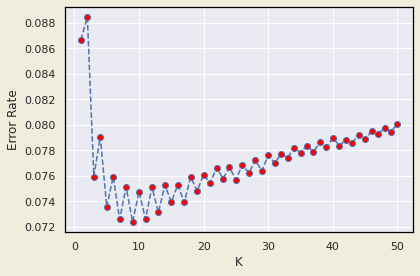

In [ ]:
plt.plot(neighbors,error_rate,marker='o',linestyle='dashed',markerfacecolor='red')
plt.xlabel('K')
plt.ylabel('Error Rate')
plt.tight_layout()
plt.show()

dari grafik diatas nilai k terbaik adalah 9 dengan error rate terendah

In [ ]:
scratch_knn = Scratch_KNearestClassification(n_neighbors=9)
scratch_knn.fit(X_train,y_train)
hasil = scratch_knn.predict(X_test)
print(classification_report(hasil,y_test))

Scratch_KNearestClassification()
              precision    recall  f1-score   support

         0.0       0.96      0.90      0.93     15452
         1.0       0.87      0.94      0.90     10441

    accuracy                           0.92     25893
   macro avg       0.91      0.92      0.92     25893
weighted avg       0.92      0.92      0.92     25893



In [ ]:
knn = KNeighborsClassifier(n_neighbors=9)
knn.fit(X_train,y_train)
hasil = knn.predict(X_test)
print(classification_report(hasil,y_test))

              precision    recall  f1-score   support

         0.0       0.95      0.90      0.93     15355
         1.0       0.87      0.94      0.90     10538

    accuracy                           0.92     25893
   macro avg       0.91      0.92      0.91     25893
weighted avg       0.92      0.92      0.92     25893



In [ ]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)

In [ ]:
X_pca = pca.fit_transform(X_test)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



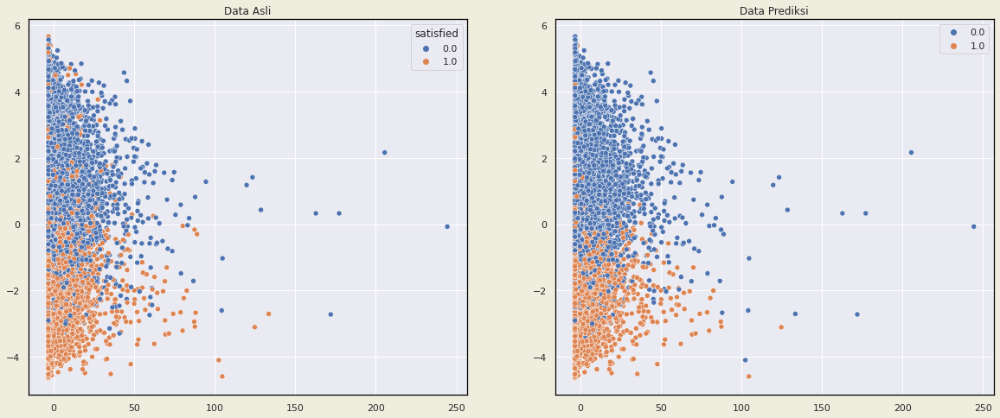

In [ ]:
fig,ax = plt.subplots(1,2,figsize=(20,8))
sns.scatterplot(X_pca[:,0],X_pca[:,1],hue=y_test,ax=ax[0])
ax[0].set_title('Data Asli')
sns.scatterplot(X_pca[:,0],X_pca[:,1],hue=hasil,ax=ax[1])
ax[1].set_title('Data Prediksi')
plt.show()

graph dikiri mewakili data asli, sedangkan graph dikanan mewakili hasil prediksi

memiliki perbedaan yang cukup terlihat dibagian atas

##### Decision Tree Classifier

In [ ]:
dtc = DecisionTreeClassifier()
dtc.fit(X_train_train,y_train_train)
print(dtc.score(X_train_train,y_train_train))
print(dtc.score(X_train_test,y_train_test))

1.0
0.9443670382165605


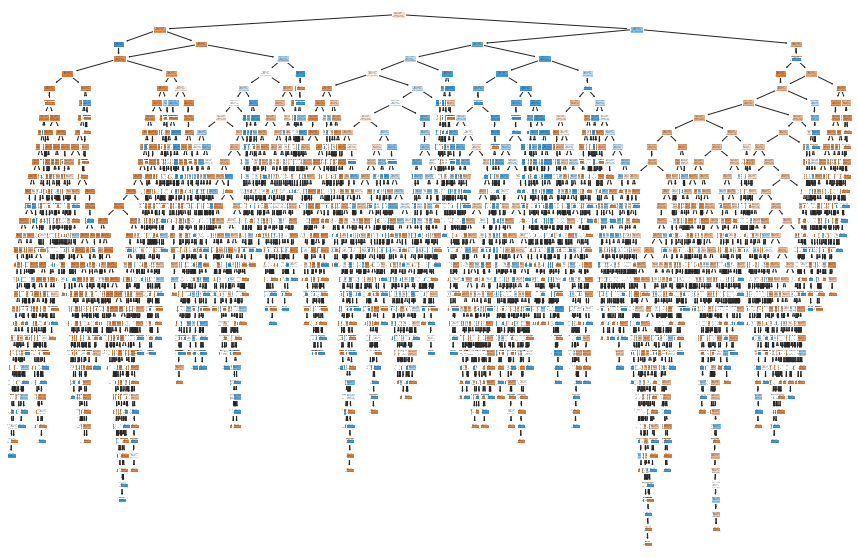

In [ ]:
plt.figure(figsize=(15,10))
plot_tree(DecisionTreeClassifier().fit(X_train_train,y_train_train),filled=True)
plt.show()

##### Random Forest Classifier

In [ ]:
rfc = RandomForestClassifier()
rfc.fit(X_train_train,y_train_train)
print(rfc.score(X_train_train,y_train_train))
print(rfc.score(X_train_test,y_train_test))

1.0
0.9620820063694268


In [ ]:
rfc.estimators_

[DecisionTreeClassifier(max_features='auto', random_state=434644068),
 DecisionTreeClassifier(max_features='auto', random_state=1004622152),
 DecisionTreeClassifier(max_features='auto', random_state=1846082853),
 DecisionTreeClassifier(max_features='auto', random_state=1361460416),
 DecisionTreeClassifier(max_features='auto', random_state=1067946827),
 DecisionTreeClassifier(max_features='auto', random_state=929288731),
 DecisionTreeClassifier(max_features='auto', random_state=1267580313),
 DecisionTreeClassifier(max_features='auto', random_state=661910572),
 DecisionTreeClassifier(max_features='auto', random_state=450797035),
 DecisionTreeClassifier(max_features='auto', random_state=1821132587),
 DecisionTreeClassifier(max_features='auto', random_state=1752563387),
 DecisionTreeClassifier(max_features='auto', random_state=827901579),
 DecisionTreeClassifier(max_features='auto', random_state=448701244),
 DecisionTreeClassifier(max_features='auto', random_state=1168624541),
 DecisionTre

In [ ]:
len(rfc.estimators_)

100

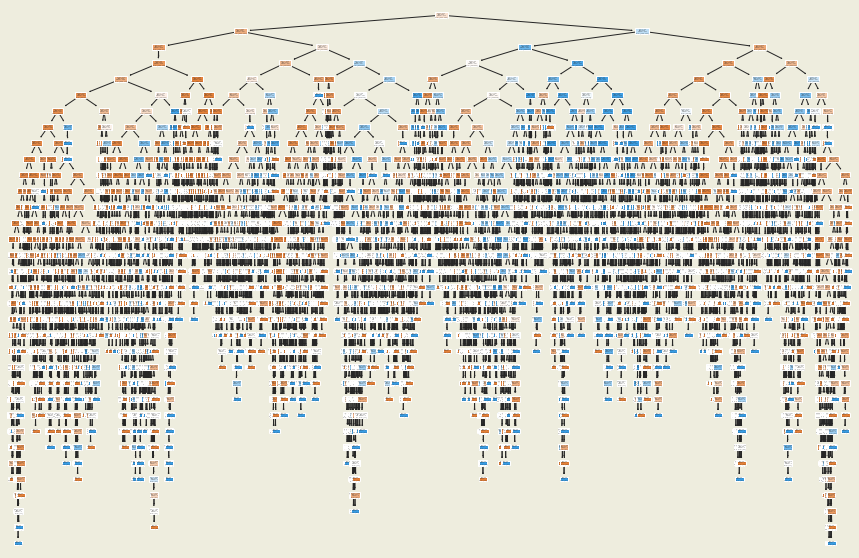

In [ ]:
plt.figure(figsize=(15,10))
plot_tree(rfc.estimators_[2],filled=True)
plt.show()

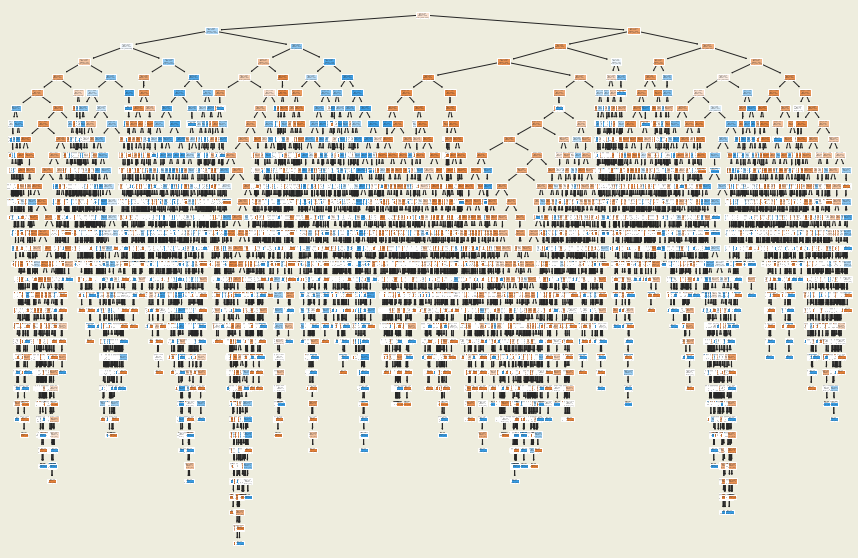

In [ ]:
plt.figure(figsize=(15,10))
plot_tree(rfc.estimators_[10],filled=True)
plt.show()

##### SVM

In [ ]:
svc = SVC()
svc.fit(X_train_train,y_train_train)
print(svc.score(X_train_train,y_train_train))
print(svc.score(X_train_test,y_train_test))

0.9561426089194929
0.9489382239382239


##### Tunning hyperparameter

In [ ]:
pipe = Pipeline([('clf', DecisionTreeClassifier())]) # Placeholder Estimator

In [ ]:
search_space = [{'clf': [DecisionTreeClassifier()],  # Actual Estimator
                    'clf__max_features':[9,10,11],'clf__max_depth':[17,18,19]},
                {'clf':[RandomForestClassifier()],
                    'clf__max_depth':[21,22,23,24,25],'clf__max_features':[9,10,11],'clf__n_estimators':[100,150,200]},
                {'clf':[SVC()],
                    'clf__C':[10],'clf__gamma':[0.1]}  
                ]

In [ ]:
cv = StratifiedKFold(n_splits=5)
gs = GridSearchCV(pipe, search_space,cv=cv,return_train_score=True,verbose=2,scoring='f1_micro')

In [ ]:
gs.fit(X_train,y_train)

Fitting 5 folds for each of 55 candidates, totalling 275 fits
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=9; total time=   0.3s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=9; total time=   0.2s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=9; total time=   0.2s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=9; total time=   0.3s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=9; total time=   0.3s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=10; total time=   0.4s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=10; total time=   0.3s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=10; total time=   0.3s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=10; total time=   0.3s
[CV] END clf=DecisionTreeClassifier(), clf__max_dept

GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('clf', DecisionTreeClassifier())]),
             param_grid=[{'clf': [DecisionTreeClassifier()],
                          'clf__max_depth': [17, 18, 19],
                          'clf__max_features': [9, 10, 11]},
                         {'clf': [RandomForestClassifier(max_depth=21,
                                                         max_features=10,
                                                         n_estimators=150)],
                          'clf__max_depth': [21, 22, 23, 24, 25],
                          'clf__max_features': [9, 10, 11],
                          'clf__n_estimators': [100, 150, 200]},
                         {'clf': [SVC()], 'clf__C': [10], 'clf__gamma': [0.1]}],
             return_train_score=True, scoring='f1_micro', verbose=2)

In [ ]:
pd.options.display.max_rows = 200
results = pd.DataFrame(gs.cv_results_)
results = results[['param_clf','params','mean_test_score','mean_train_score']].sort_values('mean_test_score',ascending=False)
results

,param_clf,params,mean_test_score,mean_train_score
13,"RandomForestClassifier(max_depth=21, max_featu...","{'clf': RandomForestClassifier(max_depth=21, m...",0.963831,0.995939
26,"RandomForestClassifier(max_depth=21, max_featu...","{'clf': RandomForestClassifier(max_depth=21, m...",0.963722,0.997236
35,"RandomForestClassifier(max_depth=21, max_featu...","{'clf': RandomForestClassifier(max_depth=21, m...",0.963672,0.998211
11,"RandomForestClassifier(max_depth=21, max_featu...","{'clf': RandomForestClassifier(max_depth=21, m...",0.963622,0.996196
16,"RandomForestClassifier(max_depth=21, max_featu...","{'clf': RandomForestClassifier(max_depth=21, m...",0.963603,0.996183
17,"RandomForestClassifier(max_depth=21, max_featu...","{'clf': RandomForestClassifier(max_depth=21, m...",0.963583,0.996146
31,"RandomForestClassifier(max_depth=21, max_featu...","{'clf': RandomForestClassifier(max_depth=21, m...",0.963583,0.998176
53,"RandomForestClassifier(max_depth=21, max_featu...","{'clf': RandomForestClassifier(max_depth=21, m...",0.963573,0.999109
44,"RandomForestClassifier(max_depth=21, max_featu...","{'clf': RandomForestClassifier(max_depth=21, m...",0.963573,0.998679
50,"RandomForestClassifier(max_depth=21, max_featu...","{'clf': RandomForestClassifier(max_depth=21, m...",0.963563,0.999072


best estimator pada gridsearch

In [ ]:
gs.best_estimator_

Pipeline(steps=[('clf',
                 RandomForestClassifier(max_depth=21, max_features=10,
                                        n_estimators=150))])

In [ ]:
pred = gs.predict(X_test)

In [ ]:
cf_matrix = confusion_matrix(pred,y_test)

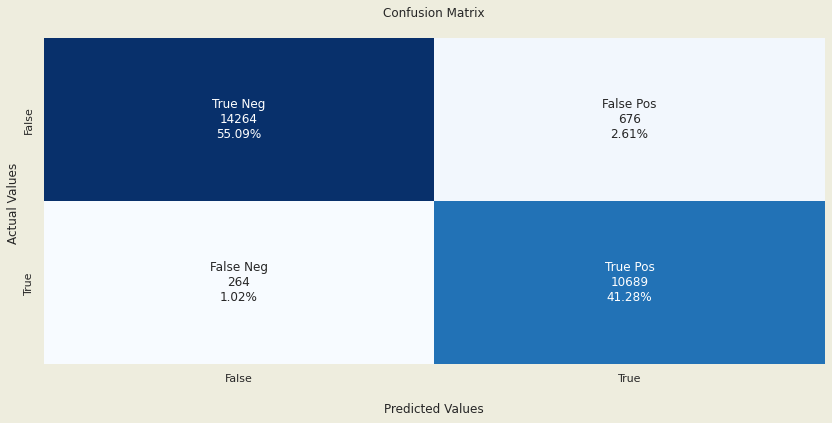

In [ ]:
sns.set(rc={'figure.facecolor':'#EEEDDE','axes.edgecolor':'black'})

group_names = ['True Neg','False Pos','False Neg','True Pos']

group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]

group_percentages = ["{0:.2%}".format(value) for value in
                     cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]

labels = np.asarray(labels).reshape(2,2)

fig,ax = plt.subplots(figsize=(14,6))
ax = sns.heatmap(cf_matrix, annot=labels, fmt='', cmap='Blues',cbar=False)

ax.set_title('Confusion Matrix\n')
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')

## Ticket labels - List must be in alphabetical order
ax.xaxis.set_ticklabels(['False','True'])
ax.yaxis.set_ticklabels(['False','True'])

## Display the visualization of the Confusion Matrix.
plt.show()

In [ ]:
print(confusion_matrix(pred,y_test))
print(classification_report(pred,y_test))

[[14264   676]
 [  264 10689]]
              precision    recall  f1-score   support

         0.0       0.98      0.95      0.97     14940
         1.0       0.94      0.98      0.96     10953

    accuracy                           0.96     25893
   macro avg       0.96      0.97      0.96     25893
weighted avg       0.96      0.96      0.96     25893



10 features terpenting pada random forest

In [ ]:
feature_importance = pd.DataFrame(gs.best_estimator_['clf'].feature_importances_)
feature_importance['label'] = X_train.columns
feature_importance.sort_values(by=0,ascending=False).head(10).reset_index(drop=True)

,0,label
0,0.239691,Online boarding
1,0.175521,Inflight wifi service
2,0.092774,Personal Travel
3,0.083426,Business
4,0.059861,Inflight entertainment
5,0.045688,Eco
6,0.037010,disloyal Customer
7,0.028800,Seat comfort
8,0.028578,Ease of Online booking
9,0.026740,Leg room service


Random Forest Tree setelah Pruning

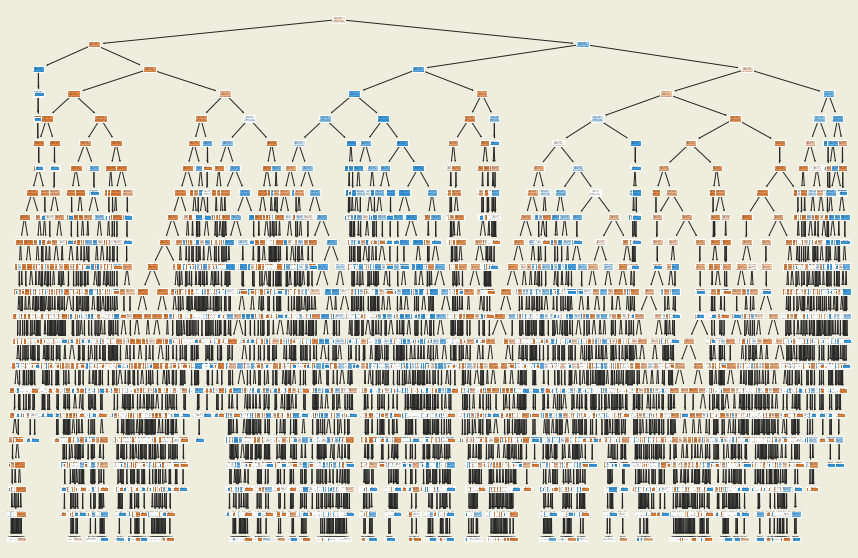

In [ ]:
plt.figure(figsize=(15,10))
plot_tree(gs.best_estimator_['clf'].estimators_[10],filled=True)
plt.show()

In [ ]:
svc = SVC(C=10,gamma=0.1)
svc.fit(X_train,y_train)
svc_nosampling_result = svc.predict(X_test)
print(classification_report(svc_nosampling_result,y_test))

              precision    recall  f1-score   support

         0.0       0.85      0.95      0.89     12998
         1.0       0.94      0.83      0.88     12895

    accuracy                           0.89     25893
   macro avg       0.89      0.89      0.89     25893
weighted avg       0.89      0.89      0.89     25893



In [ ]:
results.loc[4]['params']

{'clf': DecisionTreeClassifier(),
 'clf__max_depth': 18,
 'clf__max_features': 10}

In [ ]:
dtc = DecisionTreeClassifier(max_depth=18,max_features=10)
dtc.fit(X_train,y_train)
dtc_nosampling_result = dtc.predict(X_test)
print(classification_report(dtc_nosampling_result,y_test))

              precision    recall  f1-score   support

         0.0       0.96      0.95      0.95     14699
         1.0       0.93      0.94      0.94     11194

    accuracy                           0.94     25893
   macro avg       0.94      0.94      0.94     25893
weighted avg       0.95      0.94      0.94     25893



10 features terpenting menurut decision tree

In [ ]:
feature_importance = pd.DataFrame(dtc.feature_importances_)
feature_importance['label'] = X_train.columns
feature_importance.sort_values(by=0,ascending=False).head(10).reset_index(drop=True)

,0,label
0,0.386287,Online boarding
1,0.183791,Inflight wifi service
2,0.098716,Business
3,0.070427,Personal Travel
4,0.038244,Inflight entertainment
5,0.025818,disloyal Customer
6,0.025523,Checkin service
7,0.019191,Seat comfort
8,0.018577,Leg room service
9,0.017838,Age


Decision Tree setelah Pruning

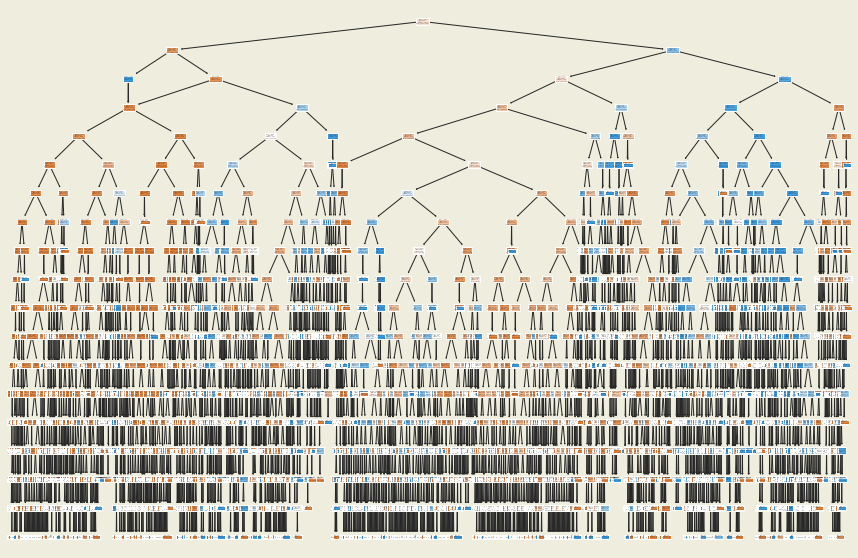

In [ ]:
plt.figure(figsize=(15,10))
plot_tree(dtc,filled=True)
plt.show()

### Metode Undersampling

#### NeighbourhoodCleaningRule & RandomUnderSampler

In [ ]:
from imblearn.under_sampling import RandomUnderSampler
from imblearn.under_sampling import NeighbourhoodCleaningRule
ncr = NeighbourhoodCleaningRule(n_neighbors=3,n_jobs=-1)
ros = RandomUnderSampler(random_state=8)

In [ ]:
y_train.value_counts()

0.0    57130
1.0    43344
Name: satisfied, dtype: int64

In [ ]:
X_ncr,y_ncr = ncr.fit_resample(X_train,y_train)
y_ncr.value_counts()

0.0    45311
1.0    43344
Name: satisfied, dtype: int64

In [ ]:
X_ncr,y_ncr = ros.fit_resample(X_ncr,y_ncr)
y_ncr.value_counts()

0.0    43344
1.0    43344
Name: satisfied, dtype: int64

In [ ]:
pipe = Pipeline([('clf', DecisionTreeClassifier())]) # Placeholder Estimator

In [ ]:
search_space = [{'clf': [DecisionTreeClassifier()],  # Actual Estimator
                    'clf__max_features':[10,11,12],'clf__max_depth':[17,18,19]},
                {'clf':[RandomForestClassifier()],
                    'clf__max_depth':[22,23,23],'clf__max_features':[8,9,10],'clf__n_estimators':[100,150,200]},
                {'clf':[SVC()],
                    'clf__C':[10],'clf__gamma':[0.01]}  
                ]

In [ ]:
cv = StratifiedKFold(n_splits=5)
gs = GridSearchCV(pipe, search_space,cv=cv,return_train_score=True,verbose=2,scoring='accuracy')

In [ ]:
gs.fit(X_ncr,y_ncr)

Fitting 5 folds for each of 37 candidates, totalling 185 fits
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=10; total time=   0.2s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=10; total time=   0.2s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=10; total time=   0.2s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=10; total time=   0.2s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=10; total time=   0.2s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=11; total time=   0.2s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=11; total time=   0.2s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=11; total time=   0.2s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=11; total time=   0.2s
[CV] END clf=DecisionTreeClassifier(), clf__max

GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('clf', DecisionTreeClassifier())]),
             param_grid=[{'clf': [DecisionTreeClassifier()],
                          'clf__max_depth': [17, 18, 19],
                          'clf__max_features': [10, 11, 12]},
                         {'clf': [RandomForestClassifier(max_depth=23,
                                                         max_features=10,
                                                         n_estimators=200)],
                          'clf__max_depth': [22, 23, 23],
                          'clf__max_features': [8, 9, 10],
                          'clf__n_estimators': [100, 150, 200]},
                         {'clf': [SVC()], 'clf__C': [10],
                          'clf__gamma': [0.01]}],
             return_train_score=True, scoring='accuracy', verbose=2)

In [ ]:
gs.best_estimator_

Pipeline(steps=[('clf',
                 RandomForestClassifier(max_depth=23, max_features=10,
                                        n_estimators=200))])

In [ ]:
pd.options.display.max_rows = 200
undersampling_results = pd.DataFrame(gs.cv_results_)
undersampling_results = undersampling_results[['param_clf','params','mean_test_score','mean_train_score']].sort_values('mean_test_score',ascending=False)
undersampling_results

,param_clf,params,mean_test_score,mean_train_score
26,"RandomForestClassifier(max_depth=23, max_featu...","{'clf': RandomForestClassifier(max_depth=23, m...",0.975741,0.998780
34,"RandomForestClassifier(max_depth=23, max_featu...","{'clf': RandomForestClassifier(max_depth=23, m...",0.975683,0.998818
35,"RandomForestClassifier(max_depth=23, max_featu...","{'clf': RandomForestClassifier(max_depth=23, m...",0.975591,0.998846
27,"RandomForestClassifier(max_depth=23, max_featu...","{'clf': RandomForestClassifier(max_depth=23, m...",0.975579,0.998849
32,"RandomForestClassifier(max_depth=23, max_featu...","{'clf': RandomForestClassifier(max_depth=23, m...",0.975579,0.998852
25,"RandomForestClassifier(max_depth=23, max_featu...","{'clf': RandomForestClassifier(max_depth=23, m...",0.975544,0.998815
33,"RandomForestClassifier(max_depth=23, max_featu...","{'clf': RandomForestClassifier(max_depth=23, m...",0.975533,0.998855
11,"RandomForestClassifier(max_depth=23, max_featu...","{'clf': RandomForestClassifier(max_depth=23, m...",0.975521,0.998518
20,"RandomForestClassifier(max_depth=23, max_featu...","{'clf': RandomForestClassifier(max_depth=23, m...",0.975521,0.998875
14,"RandomForestClassifier(max_depth=23, max_featu...","{'clf': RandomForestClassifier(max_depth=23, m...",0.975510,0.998497


In [ ]:
pred_under = gs.predict(X_test)
cf_matrix = confusion_matrix(pred_under,y_test)
print(classification_report(pred_under,y_test))

              precision    recall  f1-score   support

         0.0       0.93      0.98      0.95     13744
         1.0       0.97      0.91      0.94     12149

    accuracy                           0.95     25893
   macro avg       0.95      0.95      0.95     25893
weighted avg       0.95      0.95      0.95     25893



In [ ]:
svc = SVC(C=10,gamma=0.01)
svc.fit(X_train,y_train)
svc_undersampling_result = svc.predict(X_test)
print(classification_report(svc_undersampling_result,y_test))

              precision    recall  f1-score   support

         0.0       0.87      0.94      0.91     13469
         1.0       0.93      0.85      0.89     12424

    accuracy                           0.90     25893
   macro avg       0.90      0.90      0.90     25893
weighted avg       0.90      0.90      0.90     25893



In [ ]:
undersampling_results.loc[5]['params']

{'clf': DecisionTreeClassifier(),
 'clf__max_depth': 18,
 'clf__max_features': 12}

In [ ]:
dtc = DecisionTreeClassifier(max_depth=18,max_features=12)
dtc.fit(X_train,y_train)
dtc_undersampling_result = dtc.predict(X_test)
print(classification_report(dtc_undersampling_result,y_test))

              precision    recall  f1-score   support

         0.0       0.95      0.95      0.95     14636
         1.0       0.93      0.94      0.94     11257

    accuracy                           0.94     25893
   macro avg       0.94      0.94      0.94     25893
weighted avg       0.94      0.94      0.94     25893



### Metode Oversampling

#### Oversampling with SMOTE (Synthetic minority oversampling technique)

In [ ]:
from imblearn.over_sampling import SMOTE

smote = SMOTE(k_neighbors=9,random_state=8)

In [ ]:
X_train_smote, y_train_smote = smote.fit_resample(X_train,y_train)

In [ ]:
print(y_train.value_counts())
print(y_train_smote.value_counts())

0.0    57130
1.0    43344
Name: satisfied, dtype: int64
0.0    57130
1.0    57130
Name: satisfied, dtype: int64


In [ ]:
pipe = Pipeline([('clf', DecisionTreeClassifier())]) # Placeholder Estimator

In [ ]:
search_space = [{'clf': [DecisionTreeClassifier()],  # Actual Estimator
                    'clf__max_features':[10,11,12],'clf__max_depth':[17,18,19]},
                {'clf':[RandomForestClassifier()],
                    'clf__max_depth':[22,23,24],'clf__max_features':[8,9,10],'clf__n_estimators':[100,150,200]},
                ]

In [ ]:
cv = StratifiedKFold(n_splits=5)
gs = GridSearchCV(pipe, search_space,cv=cv,return_train_score=True,verbose=2,scoring='f1_micro')

In [ ]:
gs.fit(X_train_smote,y_train_smote)

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=10; total time=   0.4s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=10; total time=   0.4s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=10; total time=   0.4s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=10; total time=   0.4s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=10; total time=   0.4s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=11; total time=   0.5s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=11; total time=   1.0s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=11; total time=   0.5s
[CV] END clf=DecisionTreeClassifier(), clf__max_depth=17, clf__max_features=11; total time=   0.4s
[CV] END clf=DecisionTreeClassifier(), clf__max

GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('clf', DecisionTreeClassifier())]),
             param_grid=[{'clf': [DecisionTreeClassifier()],
                          'clf__max_depth': [17, 18, 19],
                          'clf__max_features': [10, 11, 12]},
                         {'clf': [RandomForestClassifier(max_depth=23,
                                                         max_features=9,
                                                         n_estimators=150)],
                          'clf__max_depth': [22, 23, 24],
                          'clf__max_features': [8, 9, 10],
                          'clf__n_estimators': [100, 150, 200]}],
             return_train_score=True, scoring='f1_micro', verbose=2)

In [ ]:
gs.best_estimator_

Pipeline(steps=[('clf',
                 RandomForestClassifier(max_depth=23, max_features=9,
                                        n_estimators=150))])

In [ ]:
smote_results = pd.DataFrame(gs.cv_results_)
smote_results=smote_results[['param_clf','params','mean_test_score','mean_train_score']].sort_values('mean_test_score',ascending=False)
smote_results

,param_clf,params,mean_test_score,mean_train_score
22,"RandomForestClassifier(max_depth=23, max_featu...","{'clf': RandomForestClassifier(max_depth=23, m...",0.966690,0.998252
23,"RandomForestClassifier(max_depth=23, max_featu...","{'clf': RandomForestClassifier(max_depth=23, m...",0.966576,0.998296
34,"RandomForestClassifier(max_depth=23, max_featu...","{'clf': RandomForestClassifier(max_depth=23, m...",0.966532,0.998709
32,"RandomForestClassifier(max_depth=23, max_featu...","{'clf': RandomForestClassifier(max_depth=23, m...",0.966532,0.998720
29,"RandomForestClassifier(max_depth=23, max_featu...","{'clf': RandomForestClassifier(max_depth=23, m...",0.966497,0.998676
19,"RandomForestClassifier(max_depth=23, max_featu...","{'clf': RandomForestClassifier(max_depth=23, m...",0.966489,0.998247
26,"RandomForestClassifier(max_depth=23, max_featu...","{'clf': RandomForestClassifier(max_depth=23, m...",0.966471,0.998232
10,"RandomForestClassifier(max_depth=23, max_featu...","{'clf': RandomForestClassifier(max_depth=23, m...",0.966436,0.997532
31,"RandomForestClassifier(max_depth=23, max_featu...","{'clf': RandomForestClassifier(max_depth=23, m...",0.966419,0.998698
28,"RandomForestClassifier(max_depth=23, max_featu...","{'clf': RandomForestClassifier(max_depth=23, m...",0.966410,0.998740


In [ ]:
pred_over = gs.predict(X_test)

In [ ]:
print(classification_report(pred_over,y_test))

              precision    recall  f1-score   support

         0.0       0.98      0.96      0.97     14891
         1.0       0.94      0.97      0.96     11002

    accuracy                           0.96     25893
   macro avg       0.96      0.97      0.96     25893
weighted avg       0.96      0.96      0.96     25893



In [ ]:
svc = SVC(C=10,gamma=0.01)
svc.fit(X_train_smote,y_train_smote)
svc_oversampling_result = svc.predict(X_test)
print(classification_report(svc_oversampling_result,y_test))

              precision    recall  f1-score   support

         0.0       0.87      0.95      0.91     13352
         1.0       0.94      0.85      0.89     12541

    accuracy                           0.90     25893
   macro avg       0.90      0.90      0.90     25893
weighted avg       0.90      0.90      0.90     25893



In [ ]:
smote_results.loc[1]['params']

{'clf': DecisionTreeClassifier(),
 'clf__max_depth': 17,
 'clf__max_features': 11}

In [ ]:
dtc = DecisionTreeClassifier(max_depth=17,max_features=11)
dtc.fit(X_train,y_train)
dtc_oversampling_result = dtc.predict(X_test)
print(classification_report(dtc_oversampling_result,y_test))

              precision    recall  f1-score   support

         0.0       0.96      0.95      0.95     14643
         1.0       0.93      0.94      0.94     11250

    accuracy                           0.95     25893
   macro avg       0.94      0.94      0.94     25893
weighted avg       0.95      0.95      0.95     25893



## Results


Pada tanpa resampling:

*   Random Forest Classifier mendapatkan hasil akurasi sebesar 96% dengan parameter 
        RandomForestClassifier(max_depth:21, max_features:10, n_estimators:150)
*   Decision Tree mendapatkan hasil akurasi sebesar 94% dengan parameter 
        DecisionTreeClassifier(max_depth: 18, max_features: 10)
*   Support Vector Classifier mendapatkan hasil akurasi sebesar 89% dengan parameter
        SupportVectorClassifier(C:10, gamma:0.1)

Under sampling:

*   Random Forest Classifier mendapatkan hasil akurasi sebesar 95% dengan parameter 
          RandomForestClassifier(max_depth=23, max_features=10,n_estimators=200)

*   Decision Tree mendapatkan hasil akurasi sebesar 94% dengan parameter 
          DecisionTreeClassifier(max_depth: 18,max_features: 12)

*   Support Vector Classifier mendapatkan hasil akurasi sebesar 90% dengan parameter 
          SupportVectorClassifier(C:10, gamma:0.1)

Over sampling:

*   Random Forest Classifier mendapatkan hasil akurasi sebesar 96% dengan parameter 
          RandomForestClassifier(max_depth=23, max_features=9,n_estimators=150)

*   Decision Tree mendapatkan hasil akurasi sebesar 95% dengan parameter 
          DecisionTreeClassifier(max_depth: 17, max_features: 11)

*   Support Vector Classifier mendapatkan hasil akurasi sebesar 90% dengan parameter 
          SupportVectorClassifier(C:10, gamma:0.1)

## Kesimpulan

Berdasarkan percobaan yang telah kami lakukan, kami dapat menyimpulkan beberapa hal diantaranya :

1. Pada 3 metode, yaitu : tanpa sampling, undersampling, dan oversampling dan juga dengan dilakukan hyperparameter tunning disetiap algoritma, hasil terbaik terdapat pada RandomForestClassifier dengan nilai tertinggi 96% di metode tanpa sampling dan oversampling , lalu algoritma kedua yaitu DecisionTree dengan nilai tertinggi 95% di metode oversampling, dan yang terakhir SVC dengan nilai 90% di undersampling & oversampling.

    Berdasarkan hasil diatas perlakuan oversampling dan undersampling membuat model SVM improve sebesar 1%, perlakuan Oversampling pada DecisionTree membuat model improve sebesar 1%, dan perlakuan Undersampling membuat akurasi RandomForest berkurang

2. kompleksitas waktu tercepat yaitu DecisionTree lalu RandomForest kemudian SuportVectorMachine

3. Features terpenting yang mempengaruhi kenyamanan penumpang berdasarkan algoritma RandomForest, yaitu:
Online boarding, Inflight wifi service, Personal Travel, Business, Inflight entertainment,Eco,disloyal Customer,Seat comfort,Ease of Online booking,Leg room service

Jadi, jika perusahaan pesawat ingin menaikan kepuasan penumpang pesawat, mereka dapat fokus pada terhadap features diatas saja tidak perlu semua hal.